In [19]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

In [20]:
# 3: 상권 코드, 
df = pd.read_csv("./seoul_rest_code4326.csv")

In [10]:
# 좌표계 전처리: epsg 5181 -> WGS84

"""
from pyproj import Proj, transform
from tqdm import tqdm

# Projection (좌표계 정의)
# UTM-K
# proj_raw = Proj(init="epsg:5181")
proj_5178 = Proj(init='epsg:5178') # UTM-K(Bassel) 도로명주소 지도 사용 중

# WGS1984
proj_WGS84 = Proj(init='epsg:4326') # Wgs84 경도/위도, GPS사용 전지구 좌표

df_proj = df.copy()
x_list = []
y_list = []

for idx, row in tqdm(df_proj.iterrows()):
    x, y = row["x좌표"], row["y좌표"]
    xt, yt = transform(proj_raw, proj_WGS84, x, y)
    x_list.append(xt)
    y_list.append(yt)

df['x좌표'] = x_list
df['y좌표'] = y_list

df.to_csv("./seoul_restaurant_code_4326.csv")
"""

'\nfrom pyproj import Proj, transform\nfrom tqdm import tqdm\n\n# Projection (좌표계 정의)\n# UTM-K\n# proj_raw = Proj(init="epsg:5181")\nproj_5178 = Proj(init=\'epsg:5178\') # UTM-K(Bassel) 도로명주소 지도 사용 중\n\n# WGS1984\nproj_WGS84 = Proj(init=\'epsg:4326\') # Wgs84 경도/위도, GPS사용 전지구 좌표\n\ndf_proj = df.copy()\nx_list = []\ny_list = []\n\nfor idx, row in tqdm(df_proj.iterrows()):\n    x, y = row["x좌표"], row["y좌표"]\n    xt, yt = transform(proj_raw, proj_WGS84, x, y)\n    x_list.append(xt)\n    y_list.append(yt)\n\ndf[\'x좌표\'] = x_list\ndf[\'y좌표\'] = y_list\n\ndf.to_csv("./seoul_restaurant_code_4326.csv")\n'

In [21]:
commercial_code = {
    "음식점": [f"CS10000{i}" for i in range(1, 9)],
    "주류점": "CS100009",
    "카페": "CS100010",
}


In [22]:
univ_df = pd.read_csv("./data/서울주요대학위도경도.csv")
univ_df.columns = ["대학교명", "y좌표", "x좌표"]
print(univ_df)

         대학교명        y좌표         x좌표
0       서울대학교  37.467086  126.949217
1       연세대학교  37.560015  126.936894
2       고려대학교  37.588073  127.034381
3       서강대학교  37.551601  126.937668
4       한양대학교  37.557541  127.042077
5      성균관대학교  37.584815  126.997200
6       중앙대학교  37.506878  126.958381
7       경희대학교  37.593834  127.052689
8    한국외국어대학교  37.596416  127.060260
9     서울시립대학교  37.583481  127.054845
10      건국대학교  37.541910  127.071699
11      동국대학교  37.556523  127.003568
12      홍익대학교  37.552811  126.924248
13      세종대학교  37.549030  127.075261
14    이화여자대학교  37.559771  126.945516
15   가톨릭대학교성신  37.586844  127.002781
16   가톨릭대학교성의  37.502571  127.005136
17   감리교신학대학교  37.567858  126.963019
18      경기대학교  37.564636  126.962547
19      광운대학교  37.619247  127.057964
20      국민대학교  37.610956  126.994557
21    덕성여자대학교  37.651675  127.014909
22    동덕여자대학교  37.605264  127.041619
23      명지대학교  37.579557  126.923965
24      삼육대학교  37.643570  127.108645
25      상명대학교  37.584891  126.997118
2

In [23]:
# 업종별 DF 분리
for i, code in enumerate(commercial_code["음식점"]):
    if i == 0:
        restaurant_df = df[df["서비스_업종_코드"] == code]
    else:
        new_df = df[df["서비스_업종_코드"] == code]
        restaurant_df = pd.concat([restaurant_df, new_df], axis='index')
        
# remove index
restaurant_df = restaurant_df.iloc[0:, 1:]

drink_df = df[df["서비스_업종_코드"] == commercial_code["주류점"]]
cafe_df = df.loc[df["서비스_업종_코드"] == commercial_code["카페"]]



In [25]:
from pyproj import Proj, transform
from haversine import haversine

def find_near(year, name, univ_loc):
    # univ_loc = [37.467086, 126.949217]
    # Projection (좌표계 정의)
    proj_5178 = Proj(init='epsg:5178') # UTM-K(Bassel) 도로명주소 지도 사용 중

    # WGS1984
    proj_WGS84 = Proj(init='epsg:4326') # Wgs84 경도/위도, GPS사용 전지구 좌표

    # xt, yt = transform(proj_5178, proj_WGS84, univ_loc[0], univ_loc[1])
    yt,xt = univ_loc


    res_df = restaurant_df

    y_res_df["distance"] = y_res_df.apply(lambda row: haversine((row["y좌표"],row["x좌표"]), (yt,xt), unit ='m'), axis='columns')
    y_drink_df["distance"] = y_drink_df.apply(lambda row: haversine((row["y좌표"],row["x좌표"]), (yt,xt), unit ='m'), axis='columns')
    y_cafe_df["distance"] = y_cafe_df.apply(lambda row: haversine((row["y좌표"],row["x좌표"]), (yt,xt), unit ='m'), axis='columns')

    res_num = y_res_df[y_res_df["distance"] < 1000].shape[0]
    dri_num = y_drink_df[y_drink_df["distance"] < 1000].shape[0]
    caf_num = y_cafe_df[y_cafe_df["distance"] < 1000].shape[0]

    rdf = y_res_df[y_res_df["distance"] <= 1500]
    ddf = y_drink_df[y_drink_df["distance"] <= 1500]
    cdf = y_cafe_df[y_cafe_df["distance"] <= 1500]
    univ_csv =  pd.concat([rdf, ddf, cdf], axis="index")
    univ_csv.insert(loc=0, column="대학명", value=name)
    print(univ_csv)

    univ_csv.to_csv("./대학별1500m가게목록.csv", mode='a')
    # row = [
    #     ["대학교명", name],
    #     ["연도", year],
    #     ["식당", res_num],
    #     ["주점", dri_num],
    #     ["카페", caf_num],
    # ]

    # # univ_csv = pd.DataFrame.from_dict(row, orient='index', columns=["대학교명", "연도", "식당", "주점", "카페"])
    # univ_csv = pd.DataFrame(row)
    # print(univ_csv, univ_csv.shape)

    # univ_csv.to_csv("./univ_near1km.csv", mode='a')



In [26]:
import warnings

# 경고메세지 끄기
warnings.filterwarnings(action='ignore')

years = [year for year in range(2017, 2022)]

for univ in univ_df.iterrows():
    for year in years:

        print(year, end=' ')
        y_res_df = restaurant_df[restaurant_df["기준_년_코드"] == year]
        y_drink_df = drink_df[drink_df["기준_년_코드"] == year]
        y_cafe_df = cafe_df[cafe_df["기준_년_코드"] == year]
        print(univ[1])
        name, y, x = univ[1]
        find_near(year, name, (y,x))


2017 대학교명         서울대학교
y좌표      37.467086
x좌표     126.949217
Name: 0, dtype: object
         대학명  기준_년_코드  기준_분기_코드    상권_코드 서비스_업종_코드 서비스_업종_코드_명   분기당_매출_금액  \
5453   서울대학교     2017         1  2110878  CS100001       한식음식점     4482451   
5469   서울대학교     2017         1  2110881  CS100001       한식음식점  4153685735   
5479   서울대학교     2017         1  2110882  CS100001       한식음식점  2066948945   
5503   서울대학교     2017         1  2110885  CS100001       한식음식점   572563148   
5511   서울대학교     2017         1  2110886  CS100001       한식음식점   537363475   
...      ...      ...       ...      ...       ...         ...         ...   
37167  서울대학교     2017         4  2110890  CS100010       커피-음료    67526414   
37185  서울대학교     2017         4  2110893  CS100010       커피-음료    22982867   
37197  서울대학교     2017         4  2110895  CS100010       커피-음료   671359080   
37225  서울대학교     2017         4  2110900  CS100010       커피-음료   323020525   
39707  서울대학교     2017         4  2120158  CS100010       

In [29]:
from pyproj import Proj, transform
from haversine import haversine

def find_near(univ_loc):
    # univ_loc = [37.467086, 126.949217]
    # Projection (좌표계 정의)
    proj_5178 = Proj(init='epsg:5178') # UTM-K(Bassel) 도로명주소 지도 사용 중

    # WGS1984
    proj_WGS84 = Proj(init='epsg:4326') # Wgs84 경도/위도, GPS사용 전지구 좌표

    # xt, yt = transform(proj_5178, proj_WGS84, univ_loc[0], univ_loc[1])
    yt,xt = univ_loc

    res_df = restaurant_df

    res_df["distance"] = res_df.apply(lambda row: haversine((row["y좌표"],row["x좌표"]), (yt,xt), unit ='m'), axis='columns')
    drink_df["distance"] = drink_df.apply(lambda row: haversine((row["y좌표"],row["x좌표"]), (yt,xt), unit ='m'), axis='columns')
    cafe_df["distance"] = cafe_df.apply(lambda row: haversine((row["y좌표"],row["x좌표"]), (yt,xt), unit ='m'), axis='columns')

    # print(res_df[res_df["distance"] < 1000])
    # print(drink_df[drink_df["distance"] < 1000])
    print(cafe_df[cafe_df["distance"] < 1000])


## 업종별 추이

In [30]:
import pandas as pd
import numpy as np

univ_store_df = pd.read_csv("./대학별1km가게목록.csv")
univ_store_df = univ_store_df[univ_store_df["대학명"] != "대학명"]
univ_store_df.to_csv("./대학별1km가게목록.csv", mode="w")

# univ_list = univ_store_df[univ_store_df["대학명"] == "대학명"]
# print(univ_list)
# print(univ_store_df.columns)

# print(univ_store_df)



In [31]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm

font_file_path_list = fm.findSystemFonts(fontpaths=None, fontext='ttf')
for font in font_file_path_list:
    print(font)

/System/Library/Fonts/Supplemental/STIXGeneral.otf
/System/Library/Fonts/Supplemental/SignPainter.ttc
/System/Library/Fonts/Helvetica.ttc
/System/Library/Fonts/Noteworthy.ttc
/System/Library/Fonts/Supplemental/Verdana Bold.ttf
/System/Library/Fonts/Supplemental/Seravek.ttc
/System/Library/Fonts/Supplemental/NotoSansSaurashtra-Regular.ttf
/System/Library/Fonts/Supplemental/Savoye LET.ttc
/System/Library/Fonts/Supplemental/DevanagariMT.ttc
/System/Library/Fonts/Supplemental/GillSans.ttc
/System/Library/Fonts/Supplemental/Chalkboard.ttc
/System/Library/Fonts/Supplemental/STIXIntSmBol.otf
/System/Library/Fonts/Supplemental/NotoSansPalmyrene-Regular.ttf
/System/Library/Fonts/Supplemental/Baskerville.ttc
/Library/Fonts/Arial Unicode.ttf
/System/Library/Fonts/Supplemental/Arial.ttf
/System/Library/Fonts/Supplemental/Lao Sangam MN.ttf
/System/Library/Fonts/Supplemental/NotoSansMiao-Regular.ttf
/System/Library/Fonts/Apple Braille Pinpoint 6 Dot.ttf
/System/Library/Fonts/Supplemental/NotoSansCha

In [34]:
from matplotlib import font_manager, rc
font_path = "./NanumGothic.ttf"
font = font_manager.FontProperties(fname=font_path).get_name()
rc('font', family=font)


findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

서울대학교 정문


findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

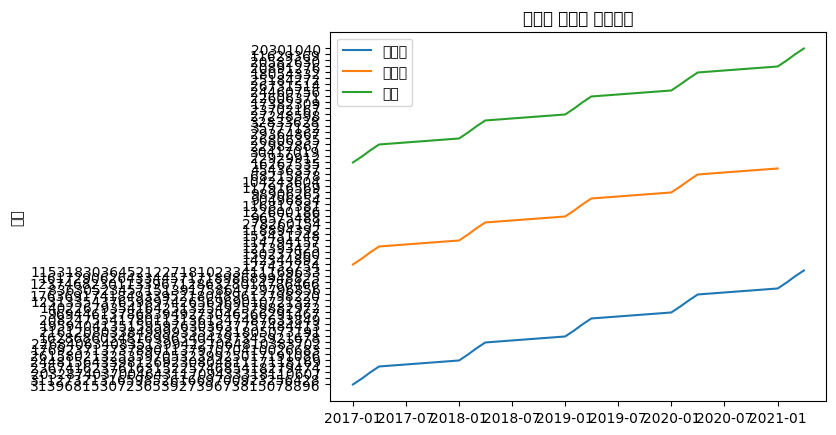

findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.


연세대학교 정문


findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

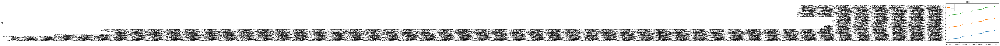

findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

고려대학교 정문


findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

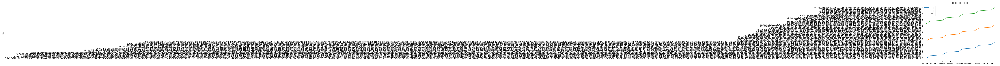

findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

서강대학교 정문


findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

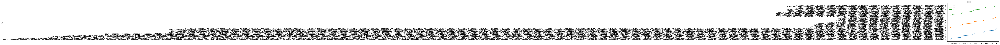

findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

한양대학교 정문


findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

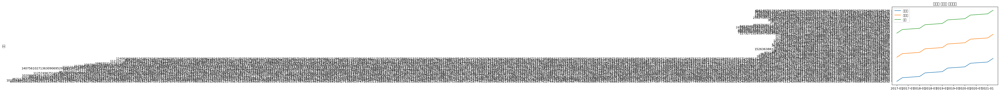

findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

성균관대학교 정문


findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

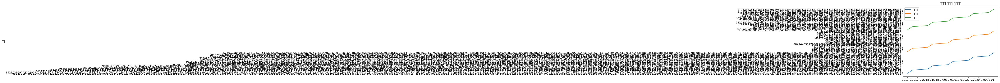

findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

중앙대학교 정문


findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

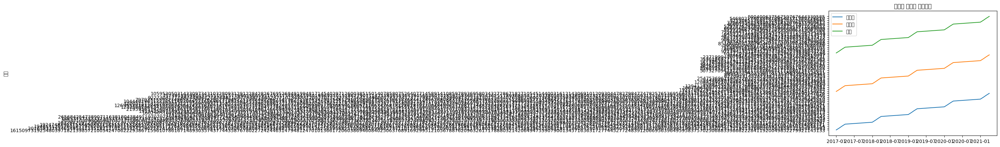

findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

경희대학교 정문


findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

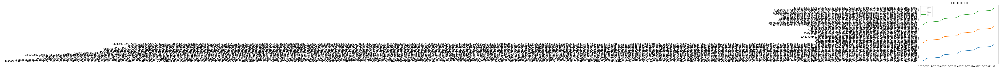

findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

한국외국어대학교 정문


findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

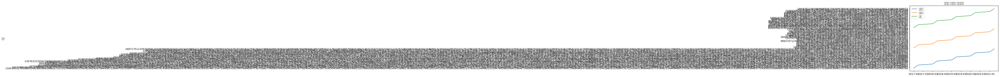

findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

시립대학교 정문


findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

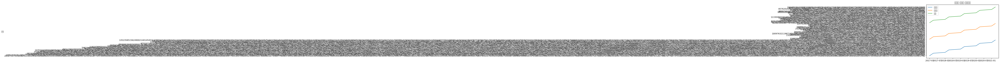

findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

건국대학교 정문


findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

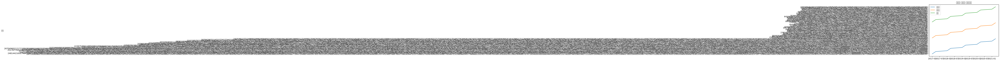

findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

동국대학교 정문


findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

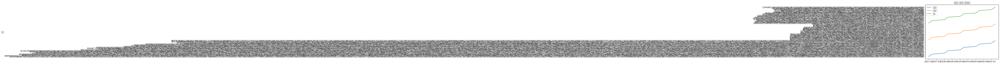

findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.


홍익대학교 정문


findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

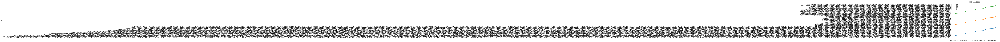

findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

세종대학교 정문


findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

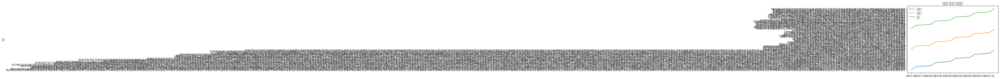

findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

이화여자대학교 정문


findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Font family 'NanumGothic' not found.
findfont: Fon

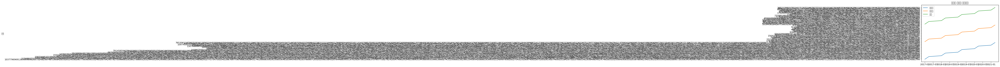

In [35]:
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm


univ_list = univ_store_df["대학명"].unique()
# print(univ_list)

for univ in univ_list:
    print(univ)
    eachuniv = univ_store_df[univ_store_df["대학명"] == univ]

    for i, code in enumerate(commercial_code["음식점"]):
        if i == 0:
            restaurant_df = eachuniv[eachuniv["서비스_업종_코드"] == code]
        else:
            new_df = eachuniv[eachuniv["서비스_업종_코드"] == code]
            restaurant_df = pd.concat([restaurant_df, new_df], axis='index')
        
    # remove index
    restaurant_df = restaurant_df.iloc[0:, 1:]

    drink_df = eachuniv[eachuniv["서비스_업종_코드"] == commercial_code["주류점"]]
    cafe_df = eachuniv.loc[eachuniv["서비스_업종_코드"] == commercial_code["카페"]]

    restaurant_df["연분기"] = restaurant_df.apply(lambda x: f'{x["기준_년_코드"]}-{x["기준_분기_코드"]}', axis="columns")
    drink_df["연분기"] = drink_df.apply(lambda x: f'{x["기준_년_코드"]}-{x["기준_분기_코드"]}', axis="columns")
    cafe_df["연분기"] = cafe_df.apply(lambda x: f'{x["기준_년_코드"]}-{x["기준_분기_코드"]}', axis="columns")


    restaurant_df.sort_values(["기준_년_코드", "기준_분기_코드"],inplace=True)
    drink_df.sort_values(["기준_년_코드", "기준_분기_코드"],inplace=True)
    cafe_df.sort_values(["기준_년_코드", "기준_분기_코드"],inplace=True)

    # restaurant_df = restaurant_df.groupby("연분기")["분기당_매출_금액"].sum()
    # drink_df = drink_df.groupby("연분기")["분기당_매출_금액"].sum()
    # cafe_df = cafe_df.groupby("연분기")["분기당_매출_금액"].sum()

    plt.plot(pd.to_datetime(restaurant_df.index), restaurant_df, label="음식점")
    plt.plot(pd.to_datetime(drink_df.index), drink_df, label="주류업")
    plt.plot(pd.to_datetime(cafe_df.index), cafe_df, label="카페")
    plt.legend()
    plt.ylabel("매출")
    plt.title("분기별 업종별 매출추이")

    plt.show()
